# Caminatas Aleatorias

In [8]:
#imports
import matplotlib.pyplot as plt
import networkx as nx
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from itertools import combinations
import random

In [3]:
def hexagonal_lattice_graph(n):
    G = nx.Graph()
    for x in range(-n+1, n):
        for y in range(-n+1, n):
            z = -x - y
            if -n < z and z < n:
                G.add_node((x, y, z))
    for node in G.nodes():
        x, y, z = node
        neighbors = [
            (x+1, y-1, z),
            (x+1, y, z-1),
            (x, y+1, z-1),
            (x-1, y+1, z),
            (x-1, y, z+1),
            (x, y-1, z+1)
        ]
        for neighbor in neighbors:
            if neighbor in G.nodes():
                G.add_edge(node, neighbor)
    return G

In [7]:
def hexagonal_positions(G):
    pos = dict()
    for node in G.nodes():
        x, y, z = node
        pos[node] = (1.5*x, np.sqrt(3) * (y + x/2))
    return pos

### These are some graphs we will use

In [24]:
## Erdos Renyi graph
erdos = nx.erdos_renyi_graph(20, 0.3)
erdospos=nx.circular_layout(erdos) 
# Square grid graph
squaregrid = nx.grid_2d_graph(m=5, n=5)
squaregridpos = {(x, y): (y, -x) for x, y in squaregrid.nodes()} 
# Small star graph 
smallstar=nx.star_graph(10)
smallstarpos = nx.spring_layout(smallstar)
# big star graph
bigstar=nx.star_graph(20)
bigstarpos = nx.spring_layout(bigstar)
# Hexagonal grid graph
hexa = hexagonal_lattice_graph(3)
hexapos = hexagonal_positions(hexa)  
# France graph

# Create a new graph object
France = nx.Graph()

# Add nodes (cities) with their latitude and longitude
Francepos = {
    "Paris": (2.3522, 48.8566),
    "Marseille": (5.3698, 43.2965),
    "Lyon": (4.8422, 45.7597),
    "Toulouse": (1.4442, 43.6047),
    "Nice": (7.2620, 43.7102),
    "Nantes": (-1.5536, 47.2184),
    "Strasbourg": (7.7521, 48.5734),
    "Lille": (3.0573, 50.6292)
}
France.add_nodes_from(Francepos.keys())

# Add edges (train connections)
connections = [("Paris", "Marseille"), ("Paris", "Lyon"), ("Paris", "Toulouse"), 
               ("Paris", "Nantes"), ("Paris", "Strasbourg"), ("Paris", "Lille"),
               ("Lyon", "Marseille"), ("Lyon", "Toulouse"), ("Lyon", "Strasbourg"),
               ("Marseille", "Nice"), ("Toulouse", "Nantes")]

France.add_edges_from(connections)


In [25]:


def randomwalk(G=smallstar,pos=smallstarpos,title="Star graph",paintnodes=False):
    # Create a directed graph
    
    
    # Add some nodes and edges


    # Calculate PageRank
    pr = nx.pagerank(G)

    # Draw the static part of the graph (nodes and edges)
    
    nx.draw_networkx_edges(G, pos)
    initial_node=random.choice(list(G.nodes()))
    frames=[initial_node]
    for i in range(50):
        frames.append(random.choice(list(G.neighbors(frames[-1]))))

    def update(node):
        ax.clear()
        ax.set_facecolor('darkslategray')
        fig.set_facecolor('darkslategray')
        nx.draw_networkx_edges(G, pos, ax=ax,edge_color='yellow')
        
        # For the animation, a random node is selected at each frame
        current_node = node
        highlighted = [current_node]
        
        color_map = ['hotpink' if node in highlighted else 'lightyellow' for node in G.nodes()]
        
        # Drawing nodes
        nx.draw_networkx_nodes(G, pos, node_color=color_map, node_size=[pr[n]*5000 for n in G.nodes()], ax=ax)
        if paintnodes:
            nx.draw_networkx_labels(G, pos,font_size=12,font_color="black")
        
        ax.set_title(f"{title}: Visiting node {current_node}",fontsize=25, color='darkslategray')

    fig, ax = plt.subplots(figsize=(10,6))
    #ani = FuncAnimation(fig, update, frames=10, repeat=True)
    ani = FuncAnimation(fig, update, frames=frames, repeat=True)
    ani_jshtml = ani.to_jshtml()
    #print(pr)
        # Display the animation
    return HTML(ani_jshtml)
    #plt.show()


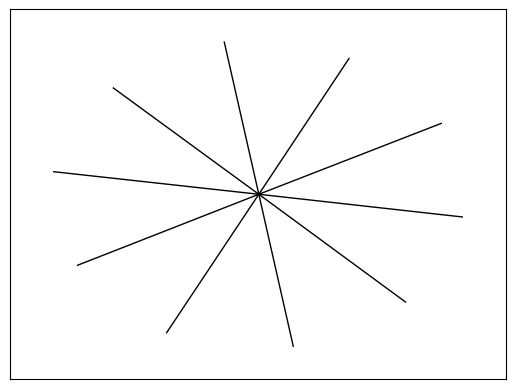

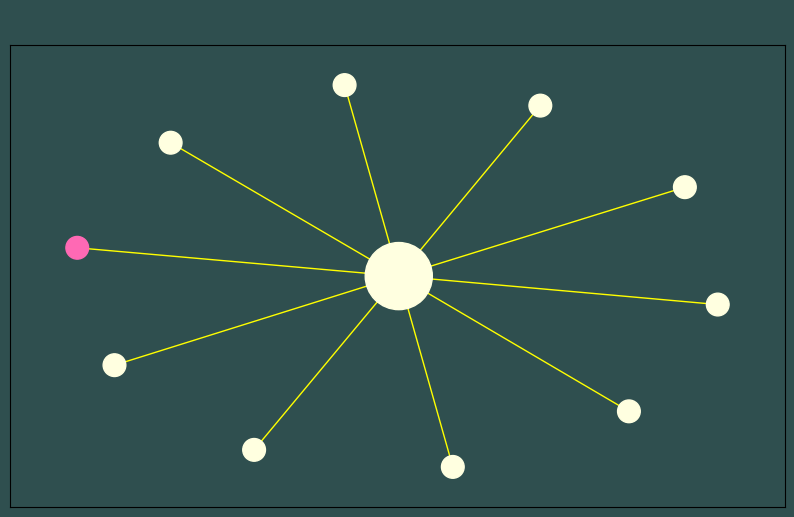

In [26]:
randomwalk(G=smallstar,pos=smallstarpos, title="Star graph")

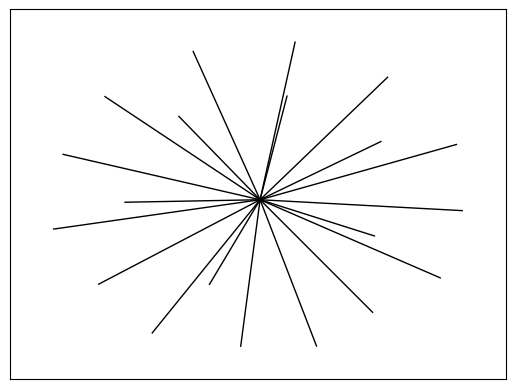

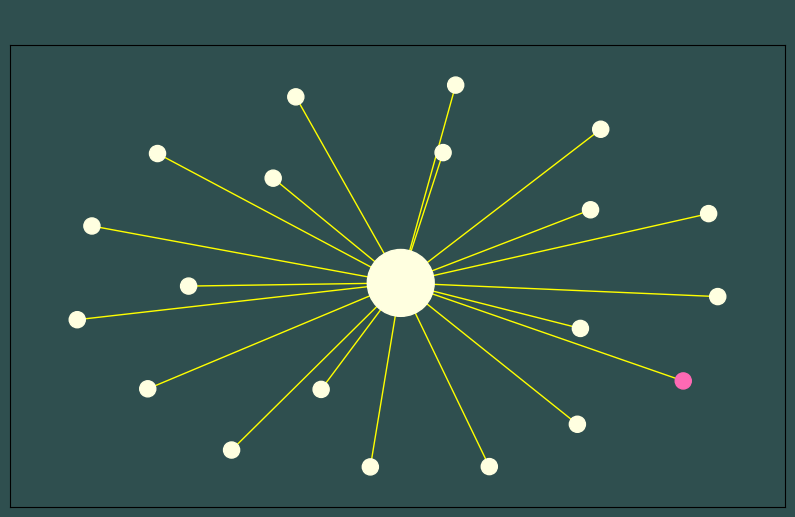

In [12]:
randomwalk(G=bigstar,pos=bigstarpos,title="Star graph")

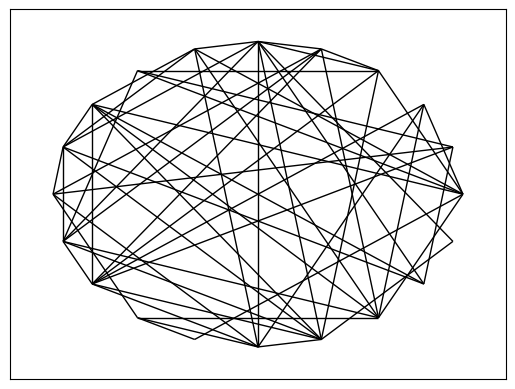

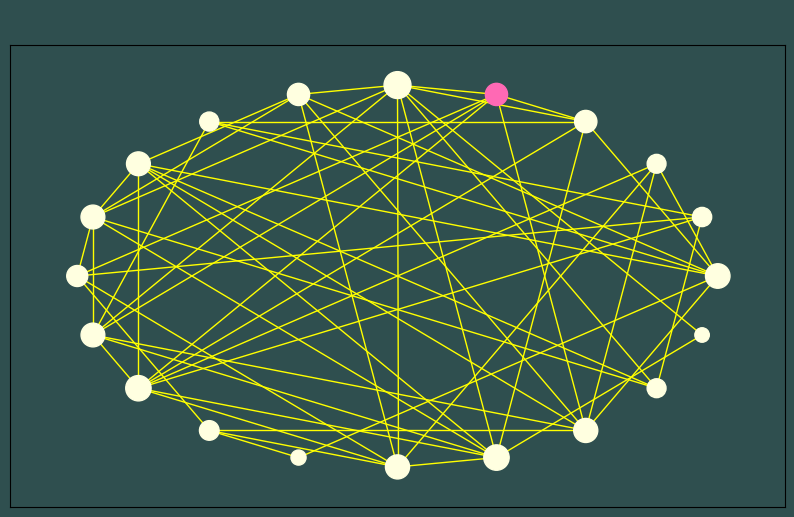

In [13]:
randomwalk(G=erdos,pos=erdospos, title=" Erdos-Renyi graph")

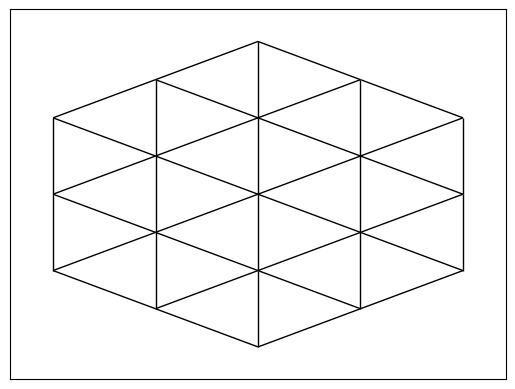

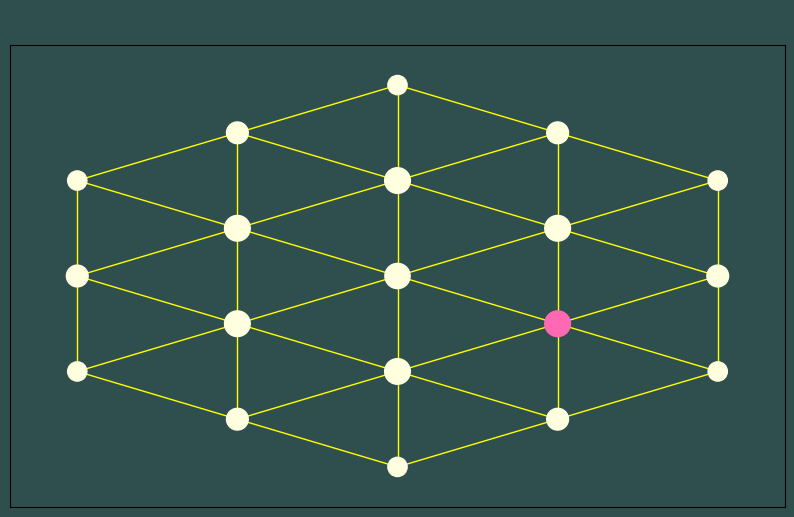

In [27]:
randomwalk(G=hexa,pos=hexapos,title="Hexagonal grid")

In [28]:
nx.pagerank(hexa,alpha=1)

{(-2, 0, 2): 0.03571466181797872,
 (-2, 1, 1): 0.04761852180164461,
 (-2, 2, 0): 0.03571466181797872,
 (-1, -1, 2): 0.04761852180164461,
 (-1, 0, 1): 0.07142877772279567,
 (-1, 1, 0): 0.07142877772279568,
 (-1, 2, -1): 0.0476185218016446,
 (0, -2, 2): 0.035714661817978714,
 (0, -1, 1): 0.07142877772279567,
 (0, 0, 0): 0.07142823194548521,
 (0, 1, -1): 0.07142877772279568,
 (0, 2, -2): 0.035714661817978714,
 (1, -2, 1): 0.0476185218016446,
 (1, -1, 0): 0.07142877772279567,
 (1, 0, -1): 0.07142877772279567,
 (1, 1, -2): 0.0476185218016446,
 (2, -2, 0): 0.035714661817978714,
 (2, -1, -1): 0.0476185218016446,
 (2, 0, -2): 0.035714661817978714}

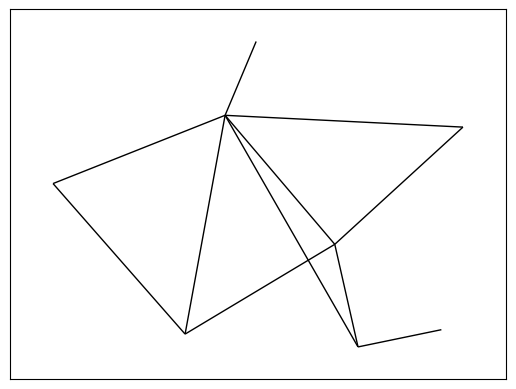

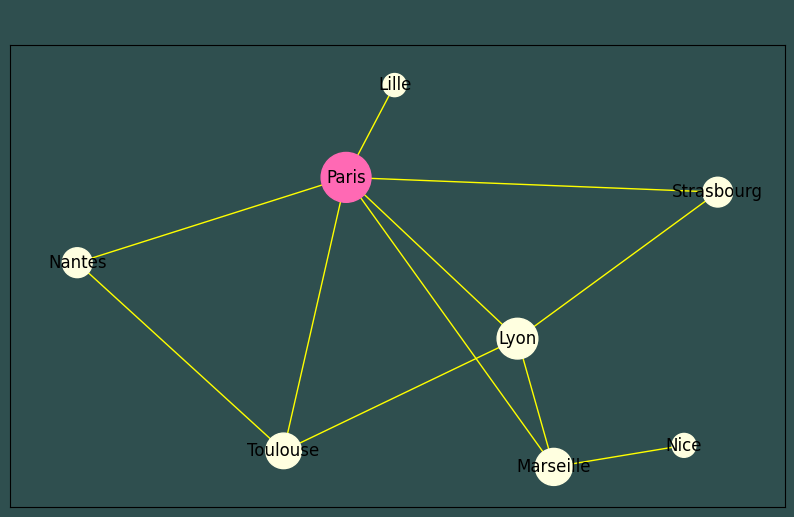

In [29]:
randomwalk(G=France,pos=Francepos,title="Francia",paintnodes=True)

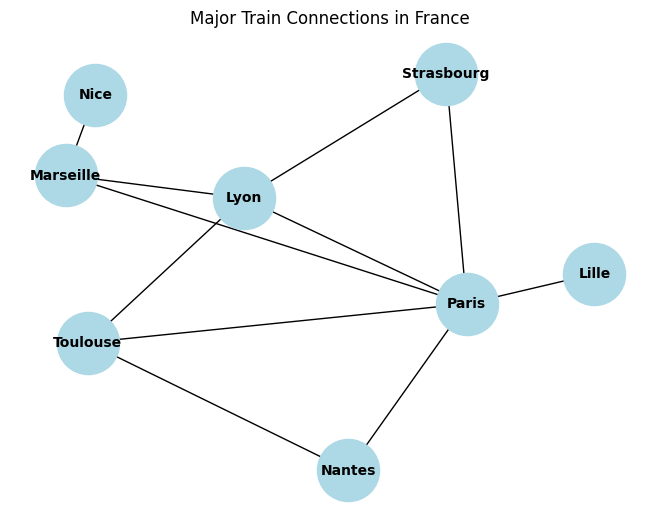

In [30]:


# Create a new graph object
G = nx.Graph()

# Add nodes (cities) with their latitude and longitude
cities = {
    "Paris": (48.8566, 2.3522),
    "Marseille": (43.2965, 5.3698),
    "Lyon": (45.7640, 4.8357),
    "Toulouse": (43.6047, 1.4442),
    "Nice": (43.7102, 7.2620),
    "Nantes": (47.2186, -1.5536),
    "Strasbourg": (48.5734, 7.7521),
    "Lille": (50.6292, 3.0573)
}
G.add_nodes_from(cities.keys())

# Add edges (train connections)
connections = [("Paris", "Marseille"), ("Paris", "Lyon"), ("Paris", "Toulouse"), 
               ("Paris", "Nantes"), ("Paris", "Strasbourg"), ("Paris", "Lille"),
               ("Lyon", "Marseille"), ("Lyon", "Toulouse"), ("Lyon", "Strasbourg"),
               ("Marseille", "Nice"), ("Toulouse", "Nantes")]

G.add_edges_from(connections)

# Draw the graph using latitude and longitude for positioning
nx.draw(G, cities, with_labels=True, node_size=2000, node_color="lightblue", font_size=10, font_color="black", font_weight="bold")
plt.title("Major Train Connections in France")
plt.show()


In [56]:
M=nx.adjacency_matrix(France).todense()

In [55]:
M.shape

AttributeError: 'NoneType' object has no attribute 'shape'

In [57]:
np.fill_diagonal(M, 1)

In [58]:
M

array([[1, 1, 1, 1, 0, 1, 1, 1],
       [1, 1, 1, 0, 1, 0, 0, 0],
       [1, 1, 1, 1, 0, 0, 1, 0],
       [1, 0, 1, 1, 0, 1, 0, 0],
       [0, 1, 0, 0, 1, 0, 0, 0],
       [1, 0, 0, 1, 0, 1, 0, 0],
       [1, 0, 1, 0, 0, 0, 1, 0],
       [1, 0, 0, 0, 0, 0, 0, 1]])

In [61]:
column_sums = M.sum(axis=0)


In [62]:
column_sums

array([7, 4, 5, 4, 2, 3, 3, 2])

In [63]:
P = M / column_sums[:, np.newaxis]

In [64]:
P[]

array([[0.14285714, 0.14285714, 0.14285714, 0.14285714, 0.        ,
        0.14285714, 0.14285714, 0.14285714],
       [0.25      , 0.25      , 0.25      , 0.        , 0.25      ,
        0.        , 0.        , 0.        ],
       [0.2       , 0.2       , 0.2       , 0.2       , 0.        ,
        0.        , 0.2       , 0.        ],
       [0.25      , 0.        , 0.25      , 0.25      , 0.        ,
        0.25      , 0.        , 0.        ],
       [0.        , 0.5       , 0.        , 0.        , 0.5       ,
        0.        , 0.        , 0.        ],
       [0.33333333, 0.        , 0.        , 0.33333333, 0.        ,
        0.33333333, 0.        , 0.        ],
       [0.33333333, 0.        , 0.33333333, 0.        , 0.        ,
        0.        , 0.33333333, 0.        ],
       [0.5       , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.5       ]])

In [37]:
nx.pagerank(France,alpha=1)

{'Paris': 0.2727265178005436,
 'Marseille': 0.13636441767051125,
 'Lyon': 0.181817644890405,
 'Toulouse': 0.13636396006230836,
 'Nice': 0.04545420603234022,
 'Nantes': 0.09090911426768641,
 'Strasbourg': 0.09090942983697256,
 'Lille': 0.04545470943923175}

In [38]:
np.linalg.matrix_power(P, 10000000)

array([[0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455],
       [0.27272727, 0.13636364, 0.18181818, 0.13636364, 0.04545455,
        0.09090909, 0.09090909, 0.04545455]])

In [67]:
n=1
math.factorial(n)**(2*n)

156769169465776230081382813324668370616746016283229482126159396667031221100038318089578741760000000000000000000000000000000000000000